In [1]:
import soundfile as sf
import pyaudio
import pickle as pk
import numpy as np
import resampy
import pretty_midi
import json
import h5py
from tqdm import tqdm
from IPython.display import display, Audio
import librosa
import os
import itertools
import random
import librosa.display
import scipy.signal
import matplotlib.pyplot as plt
import noisereduce as nr
import sklearn
from audiolazy.lazy_synth import adsr
from dppy.finite_dpps import FiniteDPP
from sklearn_extra.cluster import KMedoids
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score
from scipy.signal import hilbert
from collections.abc import Mapping
#import magenta
#import openl3
%matplotlib inline

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
SAMPLE_RATE = 16000

In [4]:
class LazyDict(Mapping):
    def __init__(self, keys, func):
        self._func = func
        self._keys = set(keys)

    def __getitem__(self, key):
        if key not in self._keys:
            raise KeyError(key)
        return self._func(key)

    def __iter__(self):
        return iter(self._keys)

    def __len__(self):
        return len(self._keys)

In [5]:
def rescale_audio(audio):
    # Standardize type to be float32 [-1, 1]
    if audio.dtype.kind == 'i':
        max_val = max(np.iinfo(audio.dtype).max, -np.iinfo(audio.dtype).min)
        inp_audio_scaled = audio.astype('float64') / max_val
    elif inp_audio.dtype.kind == 'f':
        inp_audio_scaled = audio.astype('float64')
    else:
        err_msg = 'Invalid audio dtype: {}'
        raise ValueError(err_msg.format(audio.dtype))

    # Map to the range [-2**31, 2**31]
    return (inp_audio_scaled * (2**31)).astype('float32')

# Record audio to capture soundscape events

In [6]:
recording_duration_seconds = 60.0 * 10
recording_fname = 'recording_10min_outside.wav'
num_input_samples = int(recording_duration_seconds * SAMPLE_RATE)

In [429]:
p = pyaudio.PyAudio()
inp_stream = p.open(format=pyaudio.paFloat32,
                    channels=1,
                    rate=SAMPLE_RATE,
                    input=True)
inp_audio = inp_stream.read(num_input_samples)
inp_audio = np.frombuffer(inp_audio, dtype=np.float32)
inp_stream.stop_stream()
inp_stream.close()

ALSA lib pcm.c:2660:(snd_pcm_open_noupdate) Unknown PCM cards.pcm.rear
ALSA lib pcm.c:2660:(snd_pcm_open_noupdate) Unknown PCM cards.pcm.center_lfe
ALSA lib pcm.c:2660:(snd_pcm_open_noupdate) Unknown PCM cards.pcm.side
ALSA lib pcm_route.c:877:(find_matching_chmap) Found no matching channel map
ALSA lib pcm_route.c:877:(find_matching_chmap) Found no matching channel map
ALSA lib pcm_route.c:877:(find_matching_chmap) Found no matching channel map
ALSA lib pcm_route.c:877:(find_matching_chmap) Found no matching channel map


In [430]:
# Save audio
sf.write(recording_fname, inp_audio, SAMPLE_RATE)

In [7]:
# Reload audio if it's already been recorded and saved
inp_audio, _ = sf.read(recording_fname)

In [8]:
# Denoise audio to reduce background noise
inp_audio_denoised = nr.reduce_noise(y=inp_audio, sr=SAMPLE_RATE,)

# Listen to soundscape recording

In [9]:
Audio(data=inp_audio_denoised, rate=SAMPLE_RATE)

In [10]:
# Rescale for PCEN compatibility
inp_audio_scaled = rescale_audio(inp_audio_denoised)

# Define feature extraction

In [29]:
MFCC_NUM_COEFFS = 40

def compute_mfcc(audio, sr):
    mfcc_arr = librosa.feature.mfcc(y=audio,
                                    sr=sr,
                                    n_mfcc=MFCC_NUM_COEFFS+1)[1:]
    return mfcc_arr.mean(axis=-1)


def compute_pitch(audio, sr):
    # Could also use crepe but we already have lots of deep learning
    f0, voiced_flag, voiced_prob = librosa.pyin(
        y=audio,
        fmin=librosa.note_to_hz('C2'),
        fmax=librosa.note_to_hz('C7'),
        sr=sr)
    return f0[voiced_flag].mean()


def compute_tonality(audio):
    sf = librosa.feature.spectral_flatness(y=audio)
    return 1 - sf.mean()

In [ ]:
# Currently unused
def compute_openl3(audio, sr):
    emb, ts = openl3.get_audio_embedding(audio, sr,
                                         content_type="music",
                                         input_repr="mel128",
                                         embedding_size=512)
    return emb.mean(axis=0
                    
PROJECT_DIR = os.path.abspath(os.path.join(
    os.path.dirname(os.path.abspath(__file__)), '..'))

NSYNTH_CKPT_PATH = os.path.join(PROJECT_DIR,
                                "models",
                                "wavenet-ckpt",
                                "model.ckpt-200000") 
                    
def compute_nsynth(audio, sr):
    from magenta.models.nsynth.wavenet import fastgen
    if sr != SAMPLE_RATE:
        audio = resampy.resample(audio, sr, SAMPLE_RATE)
    sample_length = len(audio)
    emb = fastgen.encode(audio, NSYNTH_CKPT_PATH, sample_length)
    emb = emb.squeeze(axis=0)
    return emb.mean(axis=0)


def compute_envelope(audio):
    analytic = hilbert(audio)
    return np.abs(analytic)

In [30]:
def get_feature_dict(audio, sr, no_audio=False):
    #openl3_emb = compute_openl3(audio, sr)
    if sr != SAMPLE_RATE:
        audio = resampy.resample(audio, sr, SAMPLE_RATE)
    sr = SAMPLE_RATE
    res = {
        'mfcc': compute_mfcc(audio, sr),
        'pitch_hz': compute_pitch(audio, sr),
        'tonality': compute_tonality(audio),
        # 'openl3': openl3_emb,
        # 'nsynth': compute_nsynth(audio, sr),
        # 'envelope': compute_envelope(audio),
    }
    res['pitch'] = pretty_midi.hz_to_note_number(res['pitch_hz'])
    if not no_audio:
        res['audio'] = audio
    return res

# Get event clips and their features from recording

In [15]:
# Get onsets
onset_n_mels = 40
onset_n_fft = int(0.025 * SAMPLE_RATE) # 25 ms
onset_hop_length = int(0.010 * SAMPLE_RATE) # 10 ms
onset_aggregate_quantile = 45
truncate_silence = False
MIN_CLIP_DURATION = 0.125
MAX_CLIP_DURATION = 1.0 # seconds

# Compute PCEN-gram (on mel-scale)
inp_stft = librosa.stft(
        inp_audio_scaled,
        n_fft=onset_n_fft,
        win_length=onset_n_fft,
        hop_length=onset_hop_length)
inp_abs2stft = (inp_stft.real*inp_stft.real) + (inp_stft.imag*inp_stft.imag)
inp_melspec = librosa.feature.melspectrogram(S=inp_abs2stft,
                                       sr=SAMPLE_RATE,
                                       n_fft=onset_n_fft,
                                       hop_length=onset_hop_length,
                                       n_mels=onset_n_mels,
                                       htk=True)
inp_pcen = librosa.pcen(S=inp_melspec,
                        sr=SAMPLE_RATE,
                        hop_length=onset_hop_length,)

# Compute onset strength envelope
def qtile(a, q=onset_aggregate_quantile, *args, **kwargs):
    return np.percentile(a, q, *args, **kwargs)
onset_env = librosa.onset.onset_strength(S=inp_pcen,
                                         sr=SAMPLE_RATE,
                                         aggregate=qtile,
                                         n_mels=128,
                                         hop_length=onset_hop_length)
times = librosa.times_like(onset_env, sr=SAMPLE_RATE, hop_length=onset_hop_length, n_fft=2048)
# Detect onsets from envelope
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_env,
                                        sr=SAMPLE_RATE,
                                        hop_length=onset_hop_length,
                                        units='frames',
                                        backtrack=True,
                                        delta=0.03,
                                        wait=0.03 * SAMPLE_RATE // onset_hop_length,
                                        pre_max=0.03 * SAMPLE_RATE // onset_hop_length,
                                        post_max=0.03 * SAMPLE_RATE // onset_hop_length,
                                        pre_avg=0.10 * SAMPLE_RATE // onset_hop_length,
                                        post_avg=0.10 * SAMPLE_RATE // onset_hop_length)
onset_idxs = librosa.core.frames_to_samples(onset_frames, hop_length=onset_hop_length)

audio_length = inp_audio.shape[0]
min_clip_length = int(MIN_CLIP_DURATION * SAMPLE_RATE)
max_clip_length = int(MAX_CLIP_DURATION * SAMPLE_RATE)


# Compute features for event clips
print(f"* computing detected event features for {len(onset_idxs)} events")
clip_list = []
for onset_idx in onset_idxs:
    # Get clip audio
    end_idx = min(onset_idx + max_clip_length, audio_length)
    clip = inp_audio_denoised[onset_idx:end_idx]
    if truncate_silence:
        # Try to truncate silence by finding the first frame with less than
        # 1% of the maximum RMS
        rms = librosa.feature.rms(clip, frame_length=WIN_LENGTH, hop_length=HOP_LENGTH).flatten()
        thresh = rms.max() * 0.01
        silent_frame_idxs = [idx for idx in np.nonzero(rms <= thresh)[0]
                             if idx >= min_clip_length]
        if len(silent_frame_idxs) > 0:
            end_idx = librosa.frames_to_samples(silent_frame_idxs[0] + 1,
                                                hop_length=HOP_LENGTH,
                                                n_fft=WIN_LENGTH)
            clip = inp_audio_denoised[onset_idx:end_idx]

    clip_dict = get_feature_dict(clip, SAMPLE_RATE)
    clip_list.append(clip_dict)

* computing detected event features for 161 events


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:17: RuntimeWarning: Mean of empty slice.


# View recording spectrogram and the location of event onsets

Text(0, 0.5, 'Onset strength')

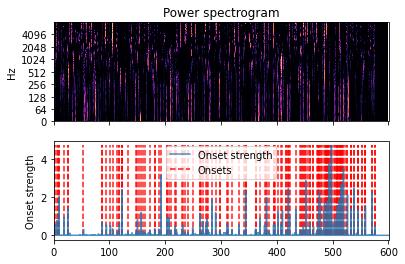

In [16]:
plt.close()
#D = librosa.amplitude_to_db(np.abs(librosa.stft(inp_audio_scaled)), ref=np.max)
D = librosa.pcen(np.abs(librosa.stft(inp_audio_scaled)))
fig, axes = plt.subplots(nrows=2, ncols=1, sharex=True)
img = librosa.display.specshow(D, y_axis='log', x_axis='s',
                               hop_length=512,
                               sr=SAMPLE_RATE, ax=axes[0])
axes[0].set_title('Power spectrogram')
axes[0].label_outer()
axes[1].plot(times, onset_env, alpha=0.8, label='Onset strength')
axes[1].vlines(times[onset_frames], 0, onset_env.max(), color='r', alpha=0.9, linestyle='--', label='Onsets')
axes[1].legend()
axes[1].set_ylabel('Onset strength')


# Cluster events as potential instruments

In [17]:
def medoid(X):
    return min(list(X), key=lambda x: ((X - x[np.newaxis, :]) ** 2).sum())

In [18]:
def get_kmeans(event_clip_list, n_clusters, feature_key):
    chunk_size = 64
    num_clips = len(event_clip_list)
    kmeans = MiniBatchKMeans(n_clusters=n_clusters)
    start_idx = 0
    while start_idx < num_clips:
        end_idx = min(start_idx + chunk_size, num_clips)
        nsynth_arr = np.array([x[feature_key]
                               for x in event_clip_list[start_idx:end_idx]])
        kmeans.partial_fit(X=nsynth_arr)
        start_idx += chunk_size
    return kmeans

In [22]:
n_clusters = None # None means we try to find the best cluster via silihoutte score
MIN_NUM_INSTRS = 5
MAX_NUM_INSTRS = 20
TONALITY_THRESHOLD = 0.5
cluster_feature_key = 'mfcc'

# Build feature matrix
event_clip_list = clip_list
X = np.array([x[cluster_feature_key] for x in event_clip_list])

if n_clusters is None:
    best_cluster_ids = None
    best_n_clusters = None
    best_score = -1

    # If we have less clips than the maximum number of instruments,
    # just consider number of clusters up to number of clips
    if len(event_clip_list) < MAX_NUM_INSTRS:
        n_cluster_list = range(1, len(event_clip_list))
    else:
        n_cluster_list = range(MIN_NUM_INSTRS, MAX_NUM_INSTRS + 1)

    for n_clusters in n_cluster_list:
        if not (n_clusters < (len(event_clip_list) - 1)):
            continue
        print(f"* trying {n_clusters} clusters")
        kmeans = get_kmeans(event_clip_list, n_clusters, cluster_feature_key)
        cluster_ids = kmeans.predict(X=X)
        try:
            score = silhouette_score(X, labels=cluster_ids)
        except ValueError:
            continue
        print(f"      + silhouette: {score}")
        if score > best_score:
            best_score = score
            best_n_clusters = n_clusters
            best_cluster_ids = cluster_ids
    n_clusters = best_n_clusters
    cluster_ids = best_cluster_ids
    print(f"* using {n_clusters} environmental clusters")
else:
    print(f"* getting {n_clusters} environmental clusters")
    kmeans = get_kmeans(event_clip_list, n_clusters, cluster_feature_key)
    cluster_ids = kmeans.predict(X=X)
    
# Group events by cluster
clusters_to_events = {}
for cluster_id, event in zip(cluster_ids, event_clip_list):
    if cluster_id not in clusters_to_events:
        clusters_to_events[cluster_id] = {'events': []}
    clusters_to_events[cluster_id]['events'].append(event)
cluster_ids = list(clusters_to_events.keys())

# Compute cluster features
for cluster_id, cluster_item in clusters_to_events.items():
    print(f"* computing features for environmental cluster {cluster_id+1}/{n_clusters}")
    X_mfcc = np.array([x['mfcc'] for x in cluster_item['events']])
    X_tonality = np.array([x['tonality'] for x in cluster_item['events']])
    cluster_item['mean_mfcc'] = X_mfcc.mean()
    cluster_item['mean_tonality'] = X_tonality.mean()
    cluster_item['is_drum'] = cluster_item['mean_tonality'] <= TONALITY_THRESHOLD
    cluster_item['num_events'] = len(cluster_item['events'])
    #cluster_item['medoid_mfcc'] = medoid(X_mfcc)
    #cluster_item['medoid_tonality'] = medoid(X_tonality)

* trying 5 clusters
      + silhouette: 0.17888103751370157
* trying 6 clusters
      + silhouette: 0.1299590063379301
* trying 7 clusters
      + silhouette: 0.1238507438545152
* trying 8 clusters
      + silhouette: 0.1638370104834106
* trying 9 clusters
      + silhouette: 0.165518228209068
* trying 10 clusters
      + silhouette: 0.1161134075804452
* trying 11 clusters
      + silhouette: 0.13913370579415946
* trying 12 clusters
      + silhouette: 0.1374524923987805
* trying 13 clusters
      + silhouette: 0.14959129744801186
* trying 14 clusters
      + silhouette: 0.1293299380138186
* trying 15 clusters
      + silhouette: 0.09430160859335658
* trying 16 clusters
      + silhouette: 0.11639605693815792
* trying 17 clusters
      + silhouette: 0.13452982326336738
* trying 18 clusters
      + silhouette: 0.09734558687079899
* trying 19 clusters
      + silhouette: 0.11610183411713355
* trying 20 clusters
      + silhouette: 0.11676081738666692
* using 5 environmental clusters
* co

# For large clusters, sample a diverse subset using DPP

In [23]:
max_events = 50
env_clusters_to_events = clusters_to_events
# Within each cluster, reduce the set of examples to at most max_events. If we have to pick a subset, use k-DPP sampling to get diverse set
reduced_env_clusters_to_events = {}
for cluster_id, cluster_item in env_clusters_to_events.items():
    if len(cluster_item['events']) >= max_events:
        X_mfcc = np.array([event['mfcc'] for event in cluster_item['events']])
        D_euc = sklearn.metrics.pairwise.euclidean_distances(X_mfcc)
        D_euc = D_euc / np.max(D_euc)
        L_euc = 1 - D_euc
        #K_euc = np.dot(L_euc, np.linalg.inv(np.eye(L_euc.shape[0]) - L_euc))
        dpp = FiniteDPP('likelihood', L=L_euc)
        subset_idxs = dpp.sample_exact_k_dpp(size=max_events)
        reduced_env_clusters_to_events[cluster_id] = dict(cluster_item)
        reduced_env_clusters_to_events[cluster_id]['events'] = [cluster_item['events'][event_idx] for event_idx in subset_idxs]
    else:
        reduced_env_clusters_to_events[cluster_id] = dict(cluster_item)


# Listen to cluster clips

In [24]:
plt.close()
show_clip_specgram = False
for cluster_id, clusters_item in clusters_to_events.items():
    print(f"Cluster {cluster_id}")
    print(f"========" + "=" * len(str(cluster_id)))
    event_idx_list = random.sample(range(len(cluster_item['events'])),
                                   min(len(cluster_item['events']), 5))
    for event_idx in event_idx_list:
        event_audio = cluster_item['events'][event_idx]['audio']
        display(Audio(data=event_audio, rate=SAMPLE_RATE))
        if show_clip_specgram:
            D = librosa.pcen(np.abs(librosa.stft(rescale_audio(event_audio))))
            fig, axes = plt.subplots(nrows=1, ncols=1, sharex=True)
            img = librosa.display.specshow(D, y_axis='log', x_axis='s',
                                           hop_length=512,
                                           sr=SAMPLE_RATE, ax=axes)
    print(f"")
    print(f"")


Cluster 2




Cluster 0




Cluster 4




Cluster 1




Cluster 3


# Choose song to generate

In [25]:
# 1) Load a specific MIDI file
midi_path = 'uptowngirl.mid'
song_name = os.path.splitext(os.path.basename(midi_path))[0]
song_dict_path = os.path.join('.', song_name + '.pkl')

# Load saved song dictionary
if not os.path.exists(song_dict_path):
    song_dict = get_midi_info(midi_path)
    with open(song_dict_path, 'wb') as f:
        pk.dump(song_dict, f)
else:
    with open(song_dict_path, 'rb') as f:
        song_dict = pk.load(f)

In [88]:
# 2) OR Load a random song from the Lakh MIDI dataset
lakh_data_dir = '/home/jsondotload/data/lmd'
max_num_songs = 50

# Utility functions for retrieving paths
def msd_id_to_dirs(msd_id):
    """Given an MSD ID, generate the path prefix.
    E.g. TRABCD12345678 -> A/B/C/TRABCD12345678"""
    return os.path.join(msd_id[2], msd_id[3], msd_id[4], msd_id)

class LakhMIDIDataset(object):
    def __init__(self, data_dir, max_num_songs=None):
        self.data_dir = data_dir
        scores_path = os.path.join(self.data_dir, 'match_scores.json')
        with open(scores_path, 'r') as f:
            scores_dict = json.load(f)

        self.songs = {}
        num_songs = len(scores_dict)
        self.msd_id_to_song_name = {}
        for song_idx, (msd_id, song_score_dict) in tqdm(enumerate(scores_dict.items()), total=num_songs):
            if len(song_score_dict) == 0:
                continue

            if (max_num_songs is not None) and (song_idx >= max_num_songs):
                break

            precompute_path = self._get_precompute_path(msd_id)
            if not os.path.exists(precompute_path):
                print(f"* processing {msd_id}")
                print(f"    + loading metadata")
                h5_path = self.msd_id_to_h5(msd_id)
                with h5py.File(h5_path, 'r') as f:
                    genre = f['metadata']['songs'][()]['genre'][0].decode()
                    title = f['metadata']['songs'][()]['title'][0].decode()
                    artist = f['metadata']['songs'][()]['artist_name'][0].decode()

                # Just get best matching MIDI
                midi_md5 = max(song_score_dict.items(), key=lambda x: x[1])[0]
                midi_path = self.get_midi_path(msd_id, midi_md5)

                song_name = f"{artist} - {title}"
                song_item = {
                    'msd_id': msd_id,
                    'midi_md5': midi_md5,
                    'genre': genre,
                    'title': title,
                    'artist': artist,
                    'name': song_name
                }
                print(f"    + analyzing midi")
                song_item.update(get_midi_info(midi_path))
                os.makedirs(os.path.dirname(precompute_path), exist_ok=True)
                with open(precompute_path, 'wb') as f:
                    pk.dump(song_item, f)
            else:
                print(f"* loading {msd_id}")
                with open(precompute_path, 'rb') as f:
                    song_item = pk.load(f)
                    song_name = f"{song_item['artist']} - {song_item['title']}"
            self.msd_id_to_song_name[msd_id] = song_name
        self.song_name_to_msd_id = {v: k for k, v in self.msd_id_to_song_name.items()}

        self.song_ids = list(sorted(self.song_name_to_msd_id.keys()))
        self.songs = LazyDict(self.song_ids, self.get_song_item)

    def get_song_item(self, song_name):
        msd_id = self.song_name_to_msd_id[song_name]
        precompute_path = self._get_precompute_path(msd_id)
        with open(precompute_path, 'rb') as f:
            song_item = pk.load(f)
        return song_item

    def msd_id_to_h5(self, msd_id):
        """Given an MSD ID, return the path to the corresponding h5"""
        return os.path.join(self.data_dir, 'lmd_matched_h5',
                            msd_id_to_dirs(msd_id) + '.h5')

    def get_midi_path(self, msd_id, midi_md5):
        """Given an MSD ID and MIDI MD5, return path to a MIDI file.
        kind should be one of 'matched' or 'aligned'. """
        return os.path.join(self.data_dir, 'lmd_matched',
                            msd_id_to_dirs(msd_id), midi_md5 + '.mid')

    def _get_precompute_path(self, msd_id):
        """Given an MSD ID and MIDI MD5, return path to a MIDI file.
        kind should be one of 'matched' or 'aligned'. """
        return os.path.join(self.data_dir, 'lmd_urbanorchestra',
                            str(msd_id) + '.pkl')


midi_dataset = LakhMIDIDataset(lakh_data_dir, max_num_songs=max_num_songs)
song_name, song_dict = random.choice(list(midi_dataset.songs.items()))

# Process MIDI file

In [32]:
synth_samples_per_instr = 10
SOUNDFONT_PATH = None#'../essential-keys-sforzando-v9.6.sf2'

pm = pretty_midi.PrettyMIDI(midi_path)
instr_to_events = {}

print(f"           ~ collecting notes")
for instr in pm.instruments:
    for note in instr.notes:
        # Get instrument name
        if instr.is_drum:
            instr_name = f"{instr.name} - {pretty_midi.note_number_to_drum_name(note.pitch)}"
        else:
            instr_name = instr.name

        if instr_name not in instr_to_events:
            instr_to_events[instr_name] = {
                'events': []
            }

        # Get information about MIDI note
        note_dict = {'program': instr.program,
                     'name': instr_name,
                     'is_drum': instr.is_drum,
                     'velocity': note.velocity,
                     'pitch': note.pitch,
                     'pitch_hz': pretty_midi.note_number_to_hz(note.pitch) if not instr.is_drum else None,
                     'start': note.start,
                     'end': note.end,
                     'duration': note.get_duration()}

        event_dict = {'midi_note': note_dict}
        instr_to_events[instr_name]['events'].append(event_dict)

for instr_name, cluster_item in instr_to_events.items():
    X_midi = np.array([[event['midi_note']['velocity'] if not np.isnan(event['midi_note']['velocity']) else 127,
                        event['midi_note']['pitch'],
                        event['midi_note']['duration']]
                       for event in cluster_item['events']])
    if X_midi.shape[0] <= synth_samples_per_instr:
        X_midi_samples = X_midi
        group_to_event_idxs = [[event_idx]
                               for event_idx in range(X_midi.shape[0])]
    else:
        # Group note events as a shortcut to save on synthesis
        # and feature extraction time
        print(f"           ~ {instr_name}: grouping note events")
        X_midi_mean = X_midi.mean(axis=0, keepdims=True)
        X_midi_std = X_midi.std(axis=0, keepdims=True)
        X_midi_pp = (X_midi - X_midi_mean) / X_midi_std
        X_midi_pp[np.logical_not(np.isfinite(X_midi_pp))] = 0.0
        kmedoids = KMedoids(n_clusters=synth_samples_per_instr)
        note_group_idxs = kmedoids.fit_predict(X_midi_pp)
        group_to_event_idxs = [[] for _ in range(synth_samples_per_instr)]
        for event_idx, group_idx in enumerate(note_group_idxs):
            group_to_event_idxs[group_idx].append(event_idx)
        X_midi_samples = kmedoids.cluster_centers_ * X_midi_std + X_midi_mean
    program_name = cluster_item['events'][0]['midi_note']['program']
    print(f"           ~ {instr_name}: synthesizing and computing audio features")
    for group_idx, (velocity, pitch, duration) in enumerate(X_midi_samples):
        # Create a dummy program to synthesize note audio
        note_pm = pretty_midi.PrettyMIDI()
        note_instr = pretty_midi.Instrument(program=program_name)
        note_pm.instruments.append(note_instr)
        note_instr.notes.append(pretty_midi.Note(velocity=int(velocity), pitch=int(pitch), start=0.0, end=duration))
        note_audio = note_pm.fluidsynth(fs=SAMPLE_RATE,
                                        sf2_path=SOUNDFONT_PATH)
        # Compute audio features from synthesized audio
        feature_dict = get_feature_dict(note_audio, SAMPLE_RATE, no_audio=True)
        for event_idx in group_to_event_idxs[group_idx]:
            cluster_item['events'][event_idx].update(feature_dict)

print(f"           ~ computing instrument features")
for instr_name, cluster_item in instr_to_events.items():
    X_mfcc = np.array([x['mfcc'] for x in cluster_item['events']])
    X_tonality = np.array([x['tonality'] for x in cluster_item['events']])
    cluster_item['mean_mfcc'] = X_mfcc.mean()
    cluster_item['mean_tonality'] = X_tonality.mean()
    # is_drum is most common value of is_drum for each note for robustness
    is_drum_lst = [x['midi_note']['is_drum'] for x in cluster_item['events']]
    cluster_item['is_drum'] = max(set(is_drum_lst), key=is_drum_lst.count)
    cluster_item['num_events'] = len(cluster_item['events'])

song_dict = {
    'duration': pm.get_end_time(),
    'instr_to_events': instr_to_events,
}


           ~ collecting notes
           ~ Uptown Girl - Billy Joel GM: grouping note events
           ~ Uptown Girl - Billy Joel GM: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ Vocal: grouping note events
           ~ Vocal: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ MutedGtr: grouping note events
           ~ MutedGtr: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ BackVocal: grouping note events
           ~ BackVocal: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ Piano: grouping note events
           ~ Piano: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ Piano2: grouping note events
           ~ Piano2: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 4 is empty! self.labels_[self.medoid_indices_[4]] may not be labeled with its corresponding cluster (4).
  "its corresponding cluster ({k}).".forma

           ~ FingeredBs: grouping note events
           ~ FingeredBs: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 4 is empty! self.labels_[self.medoid_indices_[4]] may not be labeled with its corresponding cluster (4).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 7 is empty! self.labels_[self.medoid_indices_[7]] may not be labeled with its corresponding cluster (7).
  "its corresponding cluster ({k}).".forma

           ~ Rhythm&SE - Acoustic Snare: grouping note events
           ~ Rhythm&SE - Acoustic Snare: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 4 is empty! self.labels_[self.medoid_indices_[4]] may not be labeled with its corresponding cluster (4).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 5 is empty! self.labels_[self.medoid_indices_[5]] may not be labeled with its corresponding cluster (5).
  "its corresponding cluster ({k}).".forma

           ~ Rhythm&SE - Bass Drum 1: grouping note events
           ~ Rhythm&SE - Bass Drum 1: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ Rhythm&SE - Crash Cymbal 1: grouping note events
           ~ Rhythm&SE - Crash Cymbal 1: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ Rhythm&SE - Closed Hi Hat: grouping note events
           ~ Rhythm&SE - Closed Hi Hat: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ Rhythm&SE - Ride Cymbal 1: synthesizing and computing audio features
           ~ Rhythm&SE - Low Tom: grouping note events
           ~ Rhythm&SE - Low Tom: synthesizing and computing audio features


/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in true_divide
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  "its corresponding cluster ({k}).".format(k=k)
/home/jsondotload/anaconda3/envs/magenta/lib/python3.7/site-packages/sklearn_extra/cluster/_k_medoids.py:279: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  "its corresponding cluster ({k}).".forma

           ~ Rhythm&SE - Open Hi Hat: synthesizing and computing audio features
           ~ computing instrument features


# Define audio effects

In [33]:
def res_filter(audio, f, Q=45.0):
    # Apply a resonance filter at a given frequency
    b, a = scipy.signal.iirpeak(f, Q=Q, fs=SAMPLE_RATE)
    return scipy.signal.lfilter(b, a, audio)

In [34]:
def apply_adsr(audio, attack=0.03, decay=0.1, sustain=0.7, release=0.1):
    # Apply an Attack-Decay-Sustain-Release envelope to an audio signal
    duration = len(audio)
    assert 0 < attack + decay + release < 1
    attack = int(attack * duration)
    decay = int(decay * duration)
    release = int(release * duration)
    adsr_env = np.array(list(adsr(duration, attack, decay, sustain, release)))
    return audio * adsr_env

In [35]:
def apply_note_effects(audio, f0,
                       harmonic_decay=0.5,
                       num_harmonics=4,
                       dominant_harmonic=0,
                       resonance_quality=45.0):
    assert 0 <= dominant_harmonic <= num_harmonics
    # Apply harmonic resonance filters to emphasize pitchness at
    # the corresponding fundamental
    # Harmonic weights follow a power series
    harmonic_weights = np.power(harmonic_decay, np.arange(num_harmonics) - dominant_harmonic)
    if dominant_harmonic > 0 and num_harmonics > 1:
        pre_dominant_weights = harmonic_weights[dominant_harmonic+1:min(num_harmonics, 2*dominant_harmonic + 1)]
        if len(pre_dominant_weights) < dominant_harmonic:
            pre_dominant_weights = np.pad(pre_dominant_weights, (dominant_harmonic - len(pre_dominant_weights)), mode='constant')
        harmonic_weights[:dominant_harmonic] = pre_dominant_weights
    filtered = np.zeros_like(audio)
    # Apply resonance filters
    for idx, weight in enumerate(harmonic_weights):
        n = idx + 1
        # Make sure harmonic doesn't exceed Nyquist
        if (f0 * n) < (SAMPLE_RATE / 2):
            filtered += weight * res_filter(audio, f0 * n, Q=resonance_quality)
    return filtered
    

# Create song

In [36]:
print(f"Creating environmental song || {song_name}")
num_songs = 100
HOP_LENGTH = 128
WIN_LENGTH = 512
CHUNKSIZE = 1024
DURATION_PADDING = 1.0
playback_speed = 1.0
velocity_factor = 5
min_velocity_gain = 0.25
drum_gain = 0.3
cluster_instr_compare_key = 'mean_mfcc'
cluster_feature_key = 'mfcc'
apply_pitch_filtering = True

duration = song_dict['duration'] + DURATION_PADDING
num_samples = int(duration * SAMPLE_RATE / playback_speed)
audio_out = np.zeros((num_samples,))

print(f"Arranging song")
num_instrs = len(song_dict['instr_to_events'])
for instr_idx, (instr_name, instr_item) in enumerate(song_dict['instr_to_events'].items()):
    print(f"* Instrument ({instr_idx+1}/{num_instrs}): {instr_name}")
    # If possible, only get matching drum or not-drum
    filtered_env_clusters_to_events = {k: v for k, v in reduced_env_clusters_to_events.items()
                                      if v['is_drum'] == instr_item['is_drum']} or reduced_env_clusters_to_events
    # Pick the cluster with the closest feature centroid
    env_cluster_name, env_cluster_item = min(
        filtered_env_clusters_to_events.items(),
        key=lambda x: np.sqrt(((x[1][cluster_instr_compare_key] - instr_item[cluster_instr_compare_key]) ** 2).sum()))

    # Iterate through instrument notes:
    print(f"* Producing {len(instr_item['events'])} notes")
    for instr_event_dict in instr_item['events']:
        out_start_ts = instr_event_dict['midi_note']['start']
        out_start_idx = int(out_start_ts * SAMPLE_RATE / playback_speed)
        # Get closest event in feature space
        env_event_dict = min(env_cluster_item['events'],
                             key=lambda x: np.sqrt(((x[cluster_feature_key] - instr_event_dict[cluster_feature_key]) ** 2).mean()))

        if np.isfinite(instr_event_dict['midi_note']['velocity']):
            # Map velocity to gain via a shifted logarithmic mapping
            gain = (np.log10(1.0 + instr_event_dict['midi_note']['velocity'] / velocity_factor) + min_velocity_gain) / (np.log10(1.0 + 127/velocity_factor) + min_velocity_gain)
        else:
            gain = 1.0
            
        if not instr_item['is_drum']:
            #### Pitched instrument ####
            note_audio = env_event_dict['audio']
            note_audio = note_audio / np.abs(note_audio).max()
            src_note_num = env_event_dict['pitch']
            dst_note_num = instr_event_dict['midi_note']['pitch']
            if np.isfinite(src_note_num):
                # If a pitch was detected, then try to pitch shift
                n_steps = dst_note_num - src_note_num
                # Pitch shift event to correct pitch
                note_audio = librosa.effects.pitch_shift(y=note_audio,
                                                         sr=SAMPLE_RATE,
                                                         n_steps=n_steps)
            dst_note_f0 = librosa.core.midi_to_hz(dst_note_num)
            # Emphasize note harmonic frequencies
            if apply_pitch_filtering:
                note_audio = apply_note_effects(note_audio, dst_note_f0,
                              harmonic_decay=0.7,
                              num_harmonics=3,
                              dominant_harmonic=0,
                              resonance_quality=10.0)
            # Apply ADSR envelope
            note_audio = apply_adsr(note_audio,
                                    attack=0.03, decay=0.1, sustain=0.7, release=0.1)
        else:
            #### Drum instrument ####
            # Just apply drum gain and ADSR envelope
            note_audio = drum_gain * apply_adsr(env_event_dict['audio'],
                                    attack=0.01,
                                    decay=0.02,
                                    sustain=0.7,
                                    release=0.02)

        out_end_idx = out_start_idx + len(note_audio)

        # Add audio to mix
        audio_out[out_start_idx:out_end_idx] += gain * note_audio
        
# Save song
sf.write(song_name+'.wav', audio_out, SAMPLE_RATE)

Creating environmental song || uptowngirl
Arranging song
* Instrument (1/14): Uptown Girl - Billy Joel GM
* Producing 422 notes
* Instrument (2/14): Vocal
* Producing 422 notes
* Instrument (3/14): MutedGtr
* Producing 1853 notes
* Instrument (4/14): BackVocal
* Producing 511 notes
* Instrument (5/14): Piano
* Producing 1209 notes
* Instrument (6/14): Piano2
* Producing 286 notes
* Instrument (7/14): FingeredBs
* Producing 402 notes
* Instrument (8/14): Rhythm&SE - Acoustic Snare
* Producing 232 notes
* Instrument (9/14): Rhythm&SE - Bass Drum 1
* Producing 329 notes
* Instrument (10/14): Rhythm&SE - Crash Cymbal 1
* Producing 18 notes
* Instrument (11/14): Rhythm&SE - Closed Hi Hat
* Producing 422 notes
* Instrument (12/14): Rhythm&SE - Ride Cymbal 1
* Producing 4 notes
* Instrument (13/14): Rhythm&SE - Low Tom
* Producing 18 notes
* Instrument (14/14): Rhythm&SE - Open Hi Hat
* Producing 8 notes


# Listen to the song!

In [37]:
display(Audio(data=audio_out, rate=SAMPLE_RATE))